In [1]:
import numpy as np
import matplotlib.pyplot as plt
import numba
from numba import jit
import scipy.optimize as spopt
from scipy.optimize import curve_fit

In [7]:
# set the events with the corresponding rates
@numba.jit(nopython=True)

def propensities(state,c,methylation,activation,
                delta_f=-2,mbase=3,Ki=18,Ka=2900,N=6,kR=0.1,kB=0.2,mMax=24,kAct=10**2):
    rates = np.zeros(2)
    events = np.zeros((2,2))

    # calculate free-energy difference
    f = N*np.log((1 + c/Ki)/(1 + c/Ka)) + delta_f*(state[1] - mbase)

    # set rate constants for (de)activation
    kDeact = kAct*np.exp(f)

    # check methylation states
    meth_ceiling = state[1] < mMax
    meth_floor = state[1] > 0

    # for inactive cluster
    if state[0] == 0:
        # methylation; only possible if a site is available
        rates[0] = kR*meth_ceiling*methylation
        events[0] = [0,1]

        # activity switching
        rates[1] = kAct*activation
        events[1] = [1,0]

    # for active cluster
    else:
        # demethylation; only possible if a site is occupied
        rates[0] = kB*meth_floor*methylation
        events[0] = [0,-1]

        # deactivation
        rates[1] = kDeact*activation
        events[1] = [-1,0]
        
    return rates, events

@numba.jit(nopython=True)

def gillespie_nolig(a0,m0,tf,n_steps,n_sims,step_change,cnew,n_avesteps,
                    mMax=24,methylation=True,activation=True):
    # set up arrays to hold the results
    t_grid = np.linspace(0,tf,n_steps)
    
    total = np.zeros((n_steps,2))
    total[0,0] = a0
    total[0,1] = m0
        
    delta_t = tf/n_steps
    
    ############# actual algorithm #############
    
    for i in range(n_sims):
        state = np.array([a0, m0])
        dt = 0
        time = 0
        
        for j in range(n_steps-1):
            # change concentration after step_change time steps
            if j >= step_change:
                c = cnew
            else:
                c = 100
                
            # ensure initialisation; not necessary after initial round
            if time == 0:
                # set state to extract rates and propensities
                rates, events = propensities(state,c,methylation,activation)

                # determine which event occurs
                p = np.random.uniform(0,1)*np.sum(rates)
                mask = p < np.cumsum(rates)
                event_idx = np.where(mask == True)[0][0]

                # this samples the time until the next event
                u = np.random.uniform(0,1)
                dt = -np.log(u)/np.sum(rates)
                time += dt
                
            # keep updating until we reach the end of the interval
            while time < t_grid[j+1]:                
                # time-weighted running sum
                total[j+1,:] += state*dt/delta_t
                
                # extract rates and propensities for next round
                state = state + events[event_idx]
                rates, events = propensities(state,c,methylation,activation)

                # determine which event occurs
                p = np.random.uniform(0,1)*np.sum(rates)
                mask = p < np.cumsum(rates)
                event_idx = np.where(mask == True)[0][0]

                # this samples the time until the next event
                u = np.random.uniform(0,1)
                dt = -np.log(u)/np.sum(rates)
                time += dt
            
    # this performs ensemble averaging
    av_states = total/n_sims
    
    # ensure the initial states are good
    av_states[0,0] = a0
    av_states[0,1] = m0
            
    # normalise methylation
    av_states[:,1] = av_states[:,1]/mMax
            
    return av_states, t_grid

[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]
[0. 7.]
[1. 7.]


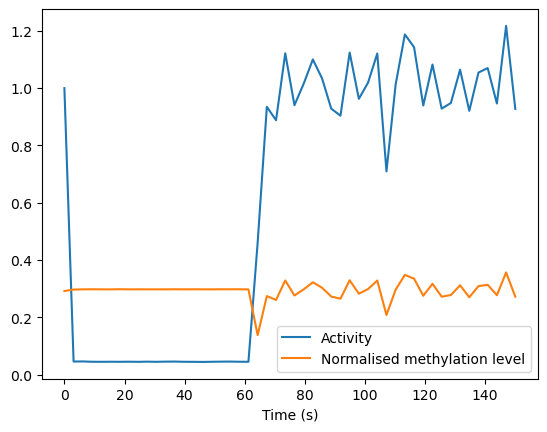

In [8]:
a0 = 1.
m0 = 7.
tf = 150
n_steps = 50
n_sims = 10**2
step_change = 20
cnew = 10
n_avesteps = 100

states, time = gillespie_nolig(a0,m0,tf,n_steps,n_sims,step_change,cnew,n_avesteps,methylation=False)

plt.plot(time, states[:,0], label='Activity')
plt.plot(time, states[:,1], label='Normalised methylation level')
plt.xlabel('Time (s)')
plt.legend()
plt.show()

In [ ]:
test1 = np.array([[8,9],[2,3]])

test2 = np.sum(test1, axis=0)
test2